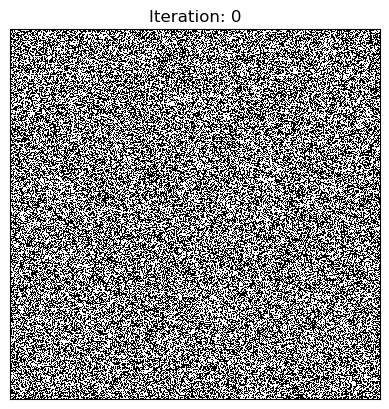

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


# Function to read grid iterations from a text file
def read_iterations_from_file(file_path,line_size=1024):
    with open(file_path, 'r') as file:
        lines = file.read().split('\n\n')  # Assume empty line separates iterations
        iterations = [[int(value) for value in line.split()] for line in lines]

    reshaped_iterations = [np.array(line).reshape(-1, line_size) for line in iterations]
    return np.array(reshaped_iterations)

# Function to update the plot for each animation frame
def update(frame):
    plt.clf()
    plt.imshow(frames[frame], cmap='binary', interpolation='none', origin='upper')
    plt.title(f'Iteration: {frame}')
    plt.xticks([])  # Hide x-axis ticks
    plt.yticks([])  # Hide y-axis ticks

# Load grid iterations from the text file
file_path = "./8_1/gameoflife_cpu_1024x1024.out"
frames = read_iterations_from_file(file_path,1024)

# Ensure consistent grid dimensions for all iterations
min_dim = min(len(iteration) for iteration in frames)
frames = np.array([iteration[:min_dim] for iteration in frames])
plt.rcParams['animation.embed_limit'] = 2**128


# Create the animation
fig, ax = plt.subplots()
animation = FuncAnimation(fig, update, frames=len(frames), interval=250)
animation.save("animation.gif")
# Show the animation

HTML(animation.to_jshtml())

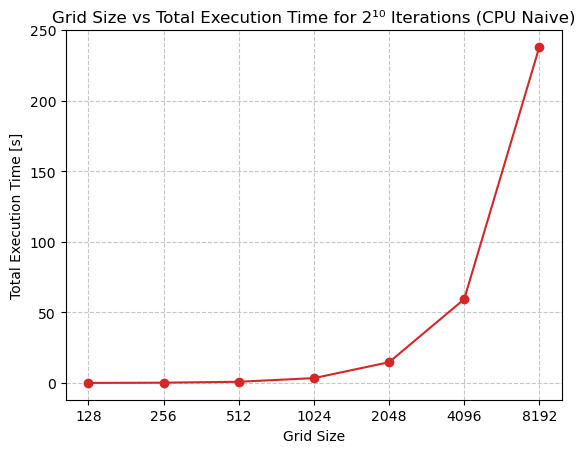

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

file_path = './8_1/times.txt'

df = pd.read_csv(file_path, delimiter=';')

grid_size = df['Grid Size']
execution_time = df ['Total Execution Time']

fig, ax1 = plt.subplots()

ax1.set_xlabel('Grid Size')
ax1.set_ylabel('Total Execution Time [s]')
ax1.set_xscale('log',base=2)
plt.xticks(grid_size, labels=[str(int(size)) for size in grid_size])
ax1.plot(grid_size, execution_time, color='tab:red', marker='o')
ax1.grid(True, linestyle='--', alpha=0.7)

plt.title('Grid Size vs Total Execution Time for 2¹⁰ Iterations (CPU Naive)')
plt.show()

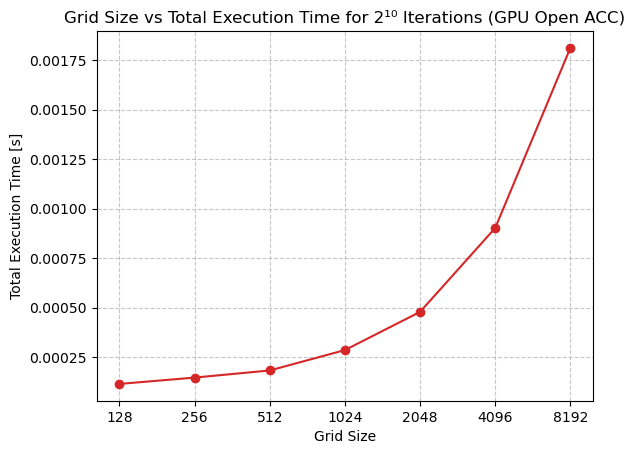

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

file_path = './8_2/times.txt'

df = pd.read_csv(file_path, delimiter=';')

grid_size = df['Grid Size']
execution_time = df ['Total Execution Time']

fig, ax1 = plt.subplots()

ax1.set_xlabel('Grid Size')
ax1.set_ylabel('Total Execution Time [s]')
ax1.set_xscale('log',base=2)
plt.xticks(grid_size, labels=[str(int(size)) for size in grid_size])
ax1.plot(grid_size, execution_time, color='tab:red', marker='o')
ax1.grid(True, linestyle='--', alpha=0.7)

plt.title('Grid Size vs Total Execution Time for 2¹⁰ Iterations (GPU Open ACC)')
plt.show()